In [1]:
import sys
import torch
import numpy as np
import math as m
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1.inset_locator import inset_axes

sys.path.append('../../')

In [2]:
import continuum

In [3]:
checkpoint_path = '../results/H2_wide/version_0/_ckpt_epoch_91.ckpt'
model = continuum.Model.load_from_checkpoint(checkpoint_path)

drift_fn = model.drift_fn
state = model.state

device = 'cuda:0'
drift_fn = drift_fn.to(device)
state = state.detach().to(device)

In [4]:
dt = 0.01
num_steps = 1024
batch_size_multiplier = 100
    
state = state.repeat([batch_size_multiplier, 1, 1])

with torch.no_grad():
    state_traj, _, _ = model.forward(state, num_steps, dt)
    state = state_traj[-1]

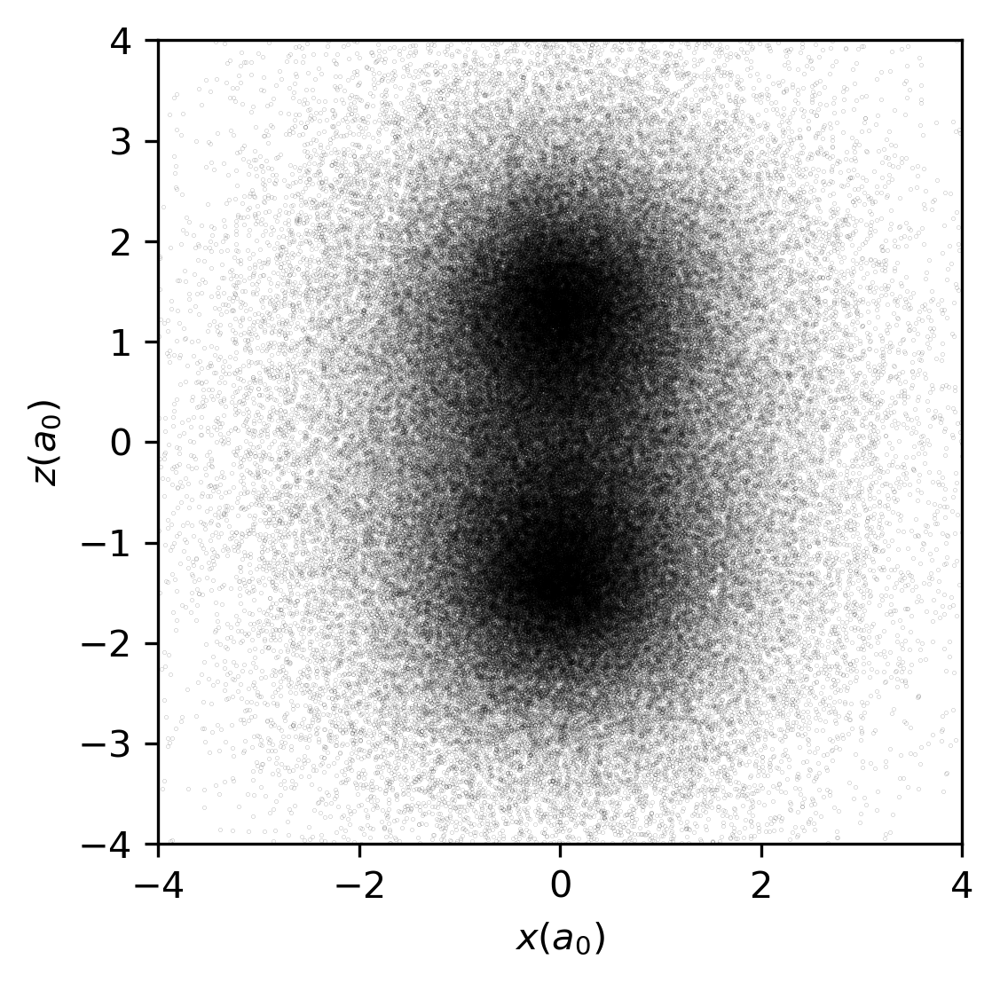

In [5]:
with torch.no_grad():
    fig, ax = plt.subplots(dpi = 300)
  
    # plot particle positions
    N = int(1.0*state.shape[0])
    np_state = (state.cpu()).numpy()
    plt.scatter(np_state[0:N, :, 0], np_state[0:N, :, 2], c='k', s=0.001)
    
    # set axes
    plt.xlabel(r'$x (a_0)$')
    plt.ylabel(r'$z (a_0)$')
    #plt.yticks([-5, 0, 5])
    border = 4
    xmin, xmax, ymin, ymax = -border, border, -border, border
    plt.xlim(xmin, xmax)
    plt.ylim(ymin, ymax)
    ax.set_aspect(aspect='equal')
    
    # show or save
    # plt.show()
    plt.savefig("H2_density.jpg", dpi=300)
    